# Import important libraries and modules

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(rc={'figure.figsize': [14, 7]}, font_scale=1.2) # Standard figure size for all

import plotly.express as px
import warnings 
warnings.filterwarnings('ignore')

from sklearn.pipeline import Pipeline

from sklearn.impute import KNNImputer
from category_encoders import BinaryEncoder,HashingEncoder
from sklearn.preprocessing import OneHotEncoder

import sklearn
sklearn.set_config(transform_output="pandas")


# Reading Data

In [2]:
zomato= pd.read_csv('zomato.csv')

In [3]:
zomato

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,Yes,Yes,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,Yes,No,4.1/5,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,Yes,No,3.8/5,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet,Banashankari
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,No,No,3.7/5,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet,Banashankari
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,No,No,3.8/5,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet,Banashankari
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,No,No,3.6 /5,27,080 40301477,Whitefield,Bar,NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars,Whitefield
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,No,No,NaN,0,+91 8197675843,Whitefield,Bar,NaN,Finger Food,600,[],[],Pubs and bars,Whitefield
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,No,No,NaN,0,NaN,Whitefield,Bar,NaN,Finger Food,"2,000",[],[],Pubs and bars,Whitefield
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,No,Yes,4.3 /5,236,080 49652769,"ITPL Main Road, Whitefield",Bar,"Cocktails, Pizza, Buttermilk",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars,Whitefield


# Exploring Data

In [4]:
#some informations
zomato.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51717 entries, 0 to 51716
Data columns (total 17 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   url                          51717 non-null  object
 1   address                      51717 non-null  object
 2   name                         51717 non-null  object
 3   online_order                 51717 non-null  object
 4   book_table                   51717 non-null  object
 5   rate                         43942 non-null  object
 6   votes                        51717 non-null  int64 
 7   phone                        50509 non-null  object
 8   location                     51696 non-null  object
 9   rest_type                    51490 non-null  object
 10  dish_liked                   23639 non-null  object
 11  cuisines                     51672 non-null  object
 12  approx_cost(for two people)  51371 non-null  object
 13  reviews_list                 51

- There are nans and approx_cost(for two people) has object type and it is price(should be float).rate has some issues and will be transformed to float. other types are right. '[]' is an empty list which is nan 

In [6]:
#check duplicates
zomato.duplicated().sum()

0

In [7]:
#check nulls
zomato.isna().sum()

url                                0
address                            0
name                               0
online_order                       0
book_table                         0
rate                            7775
votes                              0
phone                           1208
location                          21
rest_type                        227
dish_liked                     28078
cuisines                          45
approx_cost(for two people)      346
reviews_list                       0
menu_item                          0
listed_in(type)                    0
listed_in(city)                    0
dtype: int64

In [8]:
# nan percentage
zomato.isna().mean()*100

url                             0.000000
address                         0.000000
name                            0.000000
online_order                    0.000000
book_table                      0.000000
rate                           15.033741
votes                           0.000000
phone                           2.335789
location                        0.040606
rest_type                       0.438927
dish_liked                     54.291626
cuisines                        0.087012
approx_cost(for two people)     0.669026
reviews_list                    0.000000
menu_item                       0.000000
listed_in(type)                 0.000000
listed_in(city)                 0.000000
dtype: float64

* Some columns have nans but any of them exceeds 60%
    - rate                                  7775
    - phone                                 1208
    - location                              21
    - rest_type                             227
    - dish_liked                            28078
    - cuisines                                45
    - approx_cost(for two people)            346
* phone will be dropped because no need in analysis and ML
* Some issues in rate column '/' , approx_cost column ','.

In [9]:
zomato['listed_in(type)'].value_counts()

listed_in(type)
Delivery              25942
Dine-out              17779
Desserts               3593
Cafes                  1723
Drinks & nightlife     1101
Buffet                  882
Pubs and bars           697
Name: count, dtype: int64

In [10]:
zomato['rest_type'].value_counts()

rest_type
Quick Bites                   19132
Casual Dining                 10330
Cafe                           3732
Delivery                       2604
Dessert Parlor                 2263
                              ...  
Dessert Parlor, Kiosk             2
Food Court, Beverage Shop         2
Dessert Parlor, Food Court        2
Sweet Shop, Dessert Parlor        1
Quick Bites, Kiosk                1
Name: count, Length: 93, dtype: int64

* **url**

In [11]:
zomato.url.value_counts()

url
https://www.zomato.com/bangalore/jalsa-banashankari?context=eyJzZSI6eyJlIjpbNTg2OTQsIjE4Mzc1NDc0IiwiNTkwOTAiLCIxODM4Mjk0NCIsIjE4MjI0Njc2IiwiNTkyODkiLCIxODM3MzM4NiJdLCJ0IjoiUmVzdGF1cmFudHMgaW4gQmFuYXNoYW5rYXJpIHNlcnZpbmcgQnVmZmV0In19                                                                                                                                                                                                                                            1
https://www.zomato.com/bangalore/al-hayath-btm-bangalore?context=eyJzZSI6eyJlIjpbIjUyNTMwIiwiMTg3ODEzNjAiLCIxODc5MTA5MiIsIjE4ODI0MTc0Iiw2MTIxMCwiNTA2NjkiLCIxODY4MDEwNCIsIjE4MTQwNzgwIiwiMTg4NDU0NzYiLCIxODc4NTExMiIsIjE4NjY3NjQ1IiwiMTg3ODExMDUiLCI1NTM3MyIsIjE4NjgwNTAzIiwiMTg0MTc1OTYiXSwidCI6IkRpbmUtT3V0IFJlc3RhdXJhbnRzIGluIEtvcmFtYW5nYWxhIDZ0aCBCbG9jayJ9fQ==                                                                                                               1
https://www.zomato.com/bangalore/donne-biriyani-house-hs

- high cardinality and useless will be dropped

In [12]:
# copy of the data 
z = zomato.copy()

In [13]:
#drop url because of high cardinality and useless
zomato.drop(['url'],axis=1,inplace=True)

In [14]:
#check duplicates after drop url
zomato.duplicated().sum()

40

In [15]:
#duplicated data with url
dup =z[zomato.duplicated()]

In [16]:

dup[['address','name','listed_in(type)','menu_item','reviews_list']]

,address,name,listed_in(type),menu_item,reviews_list
596,"572, 30th Main, 3rd Stage, Banashankari, Banga...",My Tea House,Dine-out,"['MTH Signature Soup', 'Minestrone Veg', 'Broc...","[('Rated 4.0', ""RATED\n So apparently I visit..."
7599,"17, Thubarahalli Village, Hobli, Varthur Main ...",Nawab Di Biryani,Delivery,"['Paneer Tikka Biryani', 'Veg Lucknowi Biryani...","[('Rated 4.0', 'RATED\n Ordered paneer tikka ..."
9464,"744, 13th Main, 7th Cross, BTM 2nd Stage, BTM,...",Vyanjan,Delivery,"['Jeera Rice', 'Khichdi', 'Plain Tawa Roti', '...","[('Rated 3.0', ""RATED\n Nice place, it's for ..."
9466,"607, First Floor, 80 Feet Road, 6th Block, Kor...",Carrots,Delivery,[],"[('Rated 5.0', ""RATED\n It's the first vegan ..."
9467,"Building 58, New 3, A Main Road Marenahalli, J...",Eatsomnia,Delivery,[],"[('Rated 1.0', ""RATED\n The worst food I ate ..."
9468,"6th Cross Road, Koramangala 6th Block, Bangalore",Rolls & Co,Delivery,[],"[('Rated 2.0', 'RATED\n Order : Peri Peri Fri..."
9469,"10, Opposite Forum Mall, Taverekere, Suddagunt...",Fogg,Delivery,[],"[('Rated 5.0', 'RATED\n Seafood soup - A Thai..."
9470,"Koramangala 1st Block, Bangalore",The Paratha Stories,Delivery,[],"[('Rated 3.0', 'RATED\n There is enough scope..."
9471,"29, 7th Cross Road, Bhavani Nagar, Suddagunte ...",Mycakeshop,Delivery,"['Red Velvet Cake', 'Truffle Chocolate Cake', ...","[('Rated 5.0', 'RATED\n I loved cake nice tru..."
9549,"51, 5th Main, 60 Feet Road, BNG Homestay Build...",Bisimillah Biriyani,Delivery,[],"[('Rated 4.0', 'RATED\n Very delicious food @..."


In [17]:
dup

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
596,https://www.zomato.com/bangalore/my-tea-house-...,"572, 30th Main, 3rd Stage, Banashankari, Banga...",My Tea House,Yes,Yes,NEW,0,080 49652475,Banashankari,Casual Dining,NaN,"Continental, Asian, North Indian, Tea",500,"[('Rated 4.0', ""RATED\n So apparently I visit...","['MTH Signature Soup', 'Minestrone Veg', 'Broc...",Dine-out,Banashankari
7599,https://www.zomato.com/bangalore/nawab-di-biry...,"17, Thubarahalli Village, Hobli, Varthur Main ...",Nawab Di Biryani,Yes,No,NEW,0,+91 7899298400\r\n+91 9818654628,Whitefield,"Takeaway, Delivery",NaN,"Biryani, Mughlai",400,"[('Rated 4.0', 'RATED\n Ordered paneer tikka ...","['Paneer Tikka Biryani', 'Veg Lucknowi Biryani...",Delivery,Brookefield
9464,https://www.zomato.com/bangalore/vyanjan-btm?c...,"744, 13th Main, 7th Cross, BTM 2nd Stage, BTM,...",Vyanjan,Yes,No,3.9/5,201,+91 9916937446,BTM,Quick Bites,"Poha, Jalebi, Paratha, Bhindi Masala, Kachori,...","North Indian, Street Food",300,"[('Rated 3.0', ""RATED\n Nice place, it's for ...","['Jeera Rice', 'Khichdi', 'Plain Tawa Roti', '...",Delivery,BTM
9466,https://www.zomato.com/bangalore/carrots-koram...,"607, First Floor, 80 Feet Road, 6th Block, Kor...",Carrots,Yes,Yes,4.1/5,600,080 41172812,Koramangala 6th Block,Casual Dining,"Pizza, Pasta, Salads, Masala Chai, Soya Butter...","Italian, North Indian, Healthy Food, Desserts","1,100","[('Rated 5.0', ""RATED\n It's the first vegan ...",[],Delivery,BTM
9467,https://www.zomato.com/bangalore/eatsomnia-jp-...,"Building 58, New 3, A Main Road Marenahalli, J...",Eatsomnia,Yes,No,NEW,0,+91 9655233303,JP Nagar,Delivery,NaN,"North Indian, South Indian, Chinese, Continental",500,"[('Rated 1.0', ""RATED\n The worst food I ate ...",[],Delivery,BTM
9468,https://www.zomato.com/bangalore/rolls-co-kora...,"6th Cross Road, Koramangala 6th Block, Bangalore",Rolls & Co,Yes,No,3.9/5,213,+91 7353848635,Koramangala 6th Block,Quick Bites,"Rolls, Chicken Wings, Shawarma, Chicken Tikka ...","Burger, Beverages, Rolls",400,"[('Rated 2.0', 'RATED\n Order : Peri Peri Fri...",[],Delivery,BTM
9469,https://www.zomato.com/bangalore/fogg-btm-bang...,"10, Opposite Forum Mall, Taverekere, Suddagunt...",Fogg,No,Yes,NEW,0,+91 9148788860,BTM,Quick Bites,NaN,"Fast Food, Chinese",200,"[('Rated 5.0', 'RATED\n Seafood soup - A Thai...",[],Delivery,BTM
9470,https://www.zomato.com/bangalore/the-paratha-s...,"Koramangala 1st Block, Bangalore",The Paratha Stories,Yes,No,3.3/5,36,+91 9035955192,Koramangala 1st Block,Delivery,NaN,North Indian,400,"[('Rated 3.0', 'RATED\n There is enough scope...",[],Delivery,BTM
9471,https://www.zomato.com/bangalore/mycakeshop-bt...,"29, 7th Cross Road, Bhavani Nagar, Suddagunte ...",Mycakeshop,Yes,No,NaN,0,+91 8884555705,BTM,Bakery,NaN,"Bakery, Desserts",300,"[('Rated 5.0', 'RATED\n I loved cake nice tru...","['Red Velvet Cake', 'Truffle Chocolate Cake', ...",Delivery,BTM
9549,https://www.zomato.com/bangalore/bisimillah-bi...,"51, 5th Main, 60 Feet Road, BNG Homestay Build...",Bisimillah Biriyani,No,No,3.5/5,11,+91 8050077699\r\n+91 9731841212,BTM,Quick Bites,NaN,"Biryani, Fast Food",300,"[('Rated 4.0', 'RATED\n Very delicious food @...",[],Delivery,BTM


In [18]:
dup['url']

596      https://www.zomato.com/bangalore/my-tea-house-...
7599     https://www.zomato.com/bangalore/nawab-di-biry...
9464     https://www.zomato.com/bangalore/vyanjan-btm?c...
9466     https://www.zomato.com/bangalore/carrots-koram...
9467     https://www.zomato.com/bangalore/eatsomnia-jp-...
9468     https://www.zomato.com/bangalore/rolls-co-kora...
9469     https://www.zomato.com/bangalore/fogg-btm-bang...
9470     https://www.zomato.com/bangalore/the-paratha-s...
9471     https://www.zomato.com/bangalore/mycakeshop-bt...
9549     https://www.zomato.com/bangalore/bisimillah-bi...
9638     https://www.zomato.com/bangalore/bisimillah-bi...
12287    https://www.zomato.com/bangalore/china-south-b...
12288    https://www.zomato.com/bangalore/chination-fra...
12289    https://www.zomato.com/bangalore/desi-streat-b...
12290    https://www.zomato.com/bangalore/durga-sagar-s...
12291    https://www.zomato.com/bangalore/happy-filling...
12292    https://www.zomato.com/bangalore/marathi-biriy.

In [19]:
#drop the duplicates after dropping url 
zomato.drop_duplicates(inplace=True)

In [20]:
dup.columns[1:]

Index(['address', 'name', 'online_order', 'book_table', 'rate', 'votes',
       'phone', 'location', 'rest_type', 'dish_liked', 'cuisines',
       'approx_cost(for two people)', 'reviews_list', 'menu_item',
       'listed_in(type)', 'listed_in(city)'],
      dtype='object')

In [21]:
#check duplicates
zomato.duplicated().sum()

0

In [22]:
#phone values
zomato['phone'].value_counts()

phone
080 43334321                            216
080 43334333                            167
+91 7005889963                           78
+91 8197170008                           75
+91 7710055553                           58
                                       ... 
080 22287895\r\r\r\n080 22262195          1
+91 9686191998\r\r\r\n+91 8042115042      1
+91 9900994433\r\r\r\n080 40373737        1
080 41213522\r\r\r\n+91 8197836053        1
+91 9895674244\r\r\n+91 9611319774        1
Name: count, Length: 14926, dtype: int64

In [23]:
#drop phone useless column
zomato.drop('phone',axis=1,inplace=True)

In [24]:
#check the duplicates after dropping phone
zomato.duplicated().sum()

3

In [25]:
dupp = zomato[zomato.duplicated()]
dupp

,address,name,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
12314,"19/1, Queen's Road Cross, Munniswamy Road, Nea...",Ta'aam,Yes,No,4.1/5,402,Cunningham Road,Casual Dining,"Laham Mandi, Mutton Chops, Biryani, Mutton Sou...","North Indian, Mughlai, Arabian, Chinese",750,"[('Rated 4.0', ""RATED\n For all gluttons out ...",[],Delivery,Church Street
12322,"Alpine Annexed Apartment, Near ICICI Bank, Sha...",Promac Foods,Yes,No,NEW,0,Shanti Nagar,"Takeaway, Delivery",NaN,"North Indian, South Indian",250,[],[],Delivery,Church Street
12347,"Plot 62, Nanjappa Layout, Adugodi Main Road, A...",Ascharya Hotel,Yes,No,3.4/5,11,Koramangala 5th Block,Quick Bites,NaN,"Mangalorean, South Indian",300,"[('Rated 3.0', 'RATED\n I would say that thei...",[],Delivery,Church Street


In [26]:
z.iloc[dupp.index,7]

12314    +91 9845538234\r\n+91 9845538446
12322    +91 9845013460\r\n+91 9900760572
12347    +91 8884865531\r\n+91 9902342637
Name: phone, dtype: object

In [27]:
#drop the duplicates after dropping phone
zomato.drop_duplicates(inplace=True)

In [28]:
#reset index
zomato.reset_index(drop=True,inplace=True)

In [29]:
#check duplicates
zomato[zomato.duplicated()]

,address,name,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)


* **address**

In [30]:
zomato.groupby(['location','listed_in(city)','address']).agg({
            'name':'count',
            'address':'count'}).sort_values(by='name',ascending=False)[:20]

name  \
location                      listed_in(city)       address                                                    
HSR                           Koramangala 4th Block 14th Main, 4th Sector, HSR, Bangalore                 21   
                              HSR                   14th Main, 4th Sector, HSR, Bangalore                 20   
Varthur Main Road, Whitefield Brookefield           710, Thubarahalli, Varthur Main Road, Whitefiel...    18   
Electronic City               Electronic City       Kitchens@, 1st Floor Skywards Sun Park, Neeladr...    18   
Varthur Main Road, Whitefield Marathahalli          710, Thubarahalli, Varthur Main Road, Whitefiel...    15   
                              Whitefield            710, Thubarahalli, Varthur Main Road, Whitefiel...    13   
Indiranagar                   Indiranagar           Indiranagar, Bangalore                                13   
Residency Road                Church Street         The Ritz-Carlton, 99, Residency Road, Bangalore       13   
                              Brigade Road          The Ritz-Carlton, 99, Residency Road, Bangalore       13   
                              MG Road               The Ritz-Carlton, 99, Residency Road, Bangalore       13   
HSR                           Koramangala 6th Block 14th Main, 4th Sector, HSR, Bangalore                 12   
Residency Road                Residency Road        The Ritz-Carlton, 99, Residency Road, Bangalore       11   
                              Lavelle Road          The Ritz-Carlton, 99, Residency Road, Bangalore       11   
Sarjapur Road                 Sarjapur Road         779/71, First Floor, Near Bata Showroom, Kaikon...    11   
Whitefield                    Whitefield            Kitchens@, Trifecta Adatto, 21, ITPB Main Road,...    11   
                                                    95, Opposite Vydehi Hospital, EPIP Area, Whitef...    11   
Indiranagar                   Old Airport Road      Indiranagar, Bangalore                                11   
Sarjapur Road                 Bellandur             779/71, First Floor, Near Bata Showroom, Kaikon...    11   
Whitefield                    Brookefield           95, Opposite Vydehi Hospital, EPIP Area, Whitef...    10   
Sarjapur Road                 Sarjapur Road         6/2, Near Wipro Headquaters, Kaikondrahalli, Sa...    10   

                                                                                                        address  
location                      listed_in(city)       address                                                      
HSR                           Koramangala 4th Block 14th Main, 4th Sector, HSR, Bangalore                    21  
                              HSR                   14th Main, 4th Sector, HSR, Bangalore                    20  
Varthur Main Road, Whitefield Brookefield           710, Thubarahalli, Varthur Main Road, Whitefiel...       18  
Electronic City               Electronic City       Kitchens@, 1st Floor Skywards Sun Park, Neeladr...       18  
Varthur Main Road, Whitefield Marathahalli          710, Thubarahalli, Varthur Main Road, Whitefiel...       15  
                              Whitefield            710, Thubarahalli, Varthur Main Road, Whitefiel...       13  
Indiranagar                   Indiranagar           Indiranagar, Bangalore                                   13  
Residency Road                Church Street         The Ritz-Carlton, 99, Residency Road, Bangalore          13  
                              Brigade Road          The Ritz-Carlton, 99, Residency Road, Bangalore          13  
                              MG Road               The Ritz-Carlton, 99, Residency Road, Bangalore          13  
HSR                           Koramangala 6th Block 14th Main, 4th Sector, HSR, Bangalore                    12  
Residency Road                Residency Road        The Ritz-Carlton, 99, Residency Road, Bangalore          11  
                              Lavelle Road 

In [31]:
zomato[['address','name','votes']].value_counts().sort_index(level=2,ascending=False)

address                                                                                                                                                  name                         votes
Behind MK Retail, Sarjapur Road, Bangalore                                                                                                               Byg Brewski Brewing Company  16832     3
                                                                                                                                                                                      16345     3
298, Namma Metro Pillar 62, 100 Feet Road, Indiranagar, Bangalore                                                                                        Toit                         14956     2
28, 4th 'B' Cross, Koramangala 5th Block, Bangalore                                                                                                      Truffles                     14726     1
                                    

In [32]:
zomato.groupby(['address','name','rest_type','cuisines','listed_in(type)','rest_type','votes','rate'])[['address','votes']].count()

address  \
address                                            name                rest_type          cuisines                                listed_in(type) rest_type          votes rate              
# 31, 7th Cross, Opposite Canara Bank, Domlur, ... Vinny's             Casual Dining      Burger, Desserts, Italian, Pizza, Salad Delivery        Casual Dining      366   4.1 /5        1   
                                                                                                                                                                     367   4.1 /5        1   
                                                                                                                                  Dine-out        Casual Dining      360   4.1/5         1   
                                                                                                                                                                     366   4.1 /5        1   
# 8 (169) 11th cross S.R Nagar Residency Road, ... Venkateshwara Foods Takeaway, Delivery Street Food, South Indian               Delivery        Takeaway, Delivery 13    3.0 /5        6   
...                                                                                                                                                                                    ...   
hree Shankaranarayana 1981 & 1990/17, 28th Main... SLV Ragigudda       Quick Bites        South Indian, North Indian, Chinese     Delivery        Quick Bites        0     NEW           4   
                                                                                                                                  Dine-out        Quick Bites        0     3.7 /5        1   
                                                                                                                                                                           NEW           2   
no 32/8 8th cross, 7th Block Jayanagar, Bangalore  Tarbouche           Kiosk              Turkish, Rolls                          Delivery        Kiosk              0     NEW           1   
somasundra palaya                                  The Bigman's Cafe   Takeaway, Delivery North Indian, Chinese                   Delivery        Takeaway, Delivery 31    3.7/5         1   

                                                                                                                                                                                   votes  
address                                            name                rest_type          cuisines                                listed_in(type) rest_type          votes rate           
# 31, 7th Cross, Opposite Canara Bank, Domlur, ... Vinny's             Casual Dining      Burger, Desserts, Italian, Pizza, Salad Delivery        Casual Dining      366   4.1 /5      1  
                                                                                                                                                                     367   4.1 /5      1  
                                                                                                                                  Dine-out        Casual Dining      360   4.1/5       1  
                                                                                                                                                                     366   4.1 /5      1  
# 8 (169) 11th cross S.R Nagar Residency Road, ... Venkateshwara Foods Takeaway, Delivery Street Food, South Indian               Delivery        Takeaway, Delivery 13    3.0 /5      6  
...                                                                                                                                                                                  ...  
hree Shankaranarayana 1981 & 1990/17, 28th Main... SLV Ragigudda       Quick Bites        South Indian, North Indian, Chinese     Delivery        Quick Bites        0     NEW         4  
                         

In [33]:
zomato[(zomato['name']=='Vinny\'s')&(zomato['location']==('Banashankari'))]

,address,name,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
465,"2467, 24th Cross, 2nd Stage, Banashankari, Ban...",Vinny's,Yes,Yes,4.2/5,2115,Banashankari,Casual Dining,"Pizza, Pasta, Garlic Bread, Nachos, Penne Alfr...","Pizza, Italian, Continental, Desserts",800,"[('Rated 1.0', 'RATED\n Food - 1/5\n\nAmbienc...",[],Delivery,Banashankari
560,"2467, 24th Cross, 2nd Stage, Banashankari, Ban...",Vinny's,Yes,Yes,4.2/5,2115,Banashankari,Casual Dining,"Pizza, Pasta, Garlic Bread, Nachos, Penne Alfr...","Pizza, Italian, Continental, Desserts",800,"[('Rated 1.0', 'RATED\n Food - 1/5\n\nAmbienc...",[],Dine-out,Banashankari
2624,"2467, 24th Cross, 2nd Stage, Banashankari, Ban...",Vinny's,Yes,Yes,4.2/5,2115,Banashankari,Casual Dining,"Pizza, Pasta, Garlic Bread, Nachos, Penne Alfr...","Pizza, Italian, Continental, Desserts",800,"[('Rated 1.0', 'RATED\n Food - 1/5\n\nAmbienc...",[],Delivery,Basavanagudi
3473,"2467, 24th Cross, 2nd Stage, Banashankari, Ban...",Vinny's,Yes,Yes,4.2/5,2115,Banashankari,Casual Dining,"Pizza, Pasta, Garlic Bread, Nachos, Penne Alfr...","Pizza, Italian, Continental, Desserts",800,"[('Rated 1.0', 'RATED\n Food - 1/5\n\nAmbienc...",[],Dine-out,Basavanagudi
19634,"2467, 24th Cross, 2nd Stage, Banashankari, Ban...",Vinny's,Yes,Yes,4.2/5,2123,Banashankari,Casual Dining,"Pizza, Pasta, Garlic Bread, Nachos, Penne Alfr...","Pizza, Italian, Continental, Desserts",800,"[('Rated 5.0', 'RATED\n Best best PIZZAS. Lov...","['French Fries', 'Garlic Bread and Cheese', 'M...",Delivery,Jayanagar
21283,"2467, 24th Cross, 2nd Stage, Banashankari, Ban...",Vinny's,Yes,Yes,4.2 /5,2130,Banashankari,Casual Dining,"Pizza, Pasta, Garlic Bread, Nachos, Penne Alfr...","Pizza, Italian, Continental, Desserts",800,"[('Rated 2.0', 'RATED\n Ambiance is good but ...","['French Fries', 'Garlic Bread and Cheese', 'M...",Dine-out,Jayanagar


* **name**

In [34]:
zomato.name.value_counts()

name
Cafe Coffee Day                                            96
Onesta                                                     85
Just Bake                                                  73
Empire Restaurant                                          71
Five Star Chicken                                          70
                                                           ..
Hyderabadi Biryaani Hub                                     1
Lassi Mania                                                 1
Coastal Biryani Paradise                                    1
Momo Shop                                                   1
Plunge - Sheraton Grand Bengaluru Whitefield Hotel &...     1
Name: count, Length: 8792, dtype: int64

In [35]:
zomato[zomato.name.str.contains('Cafe')][['cuisines','rest_type','listed_in(type)']].value_counts()[:20]

cuisines                            rest_type    listed_in(type)
Cafe                                Cafe         Cafes              116
                                                 Dine-out            92
                                                 Delivery            79
Cafe, Fast Food                     Cafe         Cafes               58
                                                 Dine-out            50
                                                 Delivery            43
South Indian                        Quick Bites  Dine-out            38
Fast Food                           Quick Bites  Delivery            34
                                                 Dine-out            32
Fast Food, Beverages                Quick Bites  Dine-out            27
                                                 Delivery            25
South Indian                        Quick Bites  Delivery            23
Cafe, Continental, Beverages        Cafe         Delivery            22

* **online_order**

In [36]:
zomato.online_order.value_counts()

online_order
Yes    30410
No     21264
Name: count, dtype: int64

* **book_table**

In [37]:
zomato.book_table.value_counts()

book_table
No     45232
Yes     6442
Name: count, dtype: int64

* **rate**

In [38]:
zomato['rate'].isna().sum()

7767

In [39]:
zomato['rate'].value_counts()

rate
NEW       2200
3.9/5     2096
3.8/5     2020
3.7/5     2011
3.9 /5    1872
          ... 
2.2 /5       7
2.0 /5       7
2.0/5        4
1.8 /5       3
1.8/5        2
Name: count, Length: 64, dtype: int64

In [40]:
zomato[zomato.votes==0]['rate'].value_counts()

rate
NEW       2200
-           69
3.7 /5       4
3.6 /5       3
3.9 /5       2
3.8 /5       2
3.4 /5       2
3.3 /5       2
3.7/5        1
4.0/5        1
4.3 /5       1
4.1 /5       1
Name: count, dtype: int64

In [41]:
zomato[(zomato.votes==0)&((zomato['rate'].isna())|(zomato['rate']=='-'))]['reviews_list'].value_counts()

reviews_list
[]                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   5300
[('Rated 4.0', "R

In [42]:
zomato[(zomato['rate']=='NEW')]['reviews_list'].value_counts()

reviews_list
[]                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

In [43]:
zomato[ (zomato['votes']==0)&(zomato['reviews_list']=='[]')]['rate'].value_counts()

rate
NEW    1152
-        45
Name: count, dtype: int64

In [44]:
zomato[(zomato['rate']=='NEW')&(zomato['votes']==0)]['reviews_list'].value_counts()

reviews_list
[]                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

- rate which is NEW will be dropped because we need to analysis and predict with working restaurants.Nulls & '-' rates will be replaced by 0 when there is no votes or reviews. if there are reviews Nulls &"-" rates will be replaced with the average of rates in these reviews. 

- NaN values,'-'  of rate which have 0 votes and empty reviews_list will be replaced with 0

In [45]:
(zomato[(zomato['rate'].isna()) & (zomato['votes']!=0)])

,address,name,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
21006,"718, 1st C Main, 45th Cross, 8th Block, Jayana...",Shivaji Military Hotel,No,No,NaN,2497,Jayanagar,Casual Dining,"Mutton Biryani, Mutton Fry, Donne Biryani, Chi...","South Indian, Biryani",450,"[('Rated 5.0', ""RATED\n Wanted to visit this ...",[],Dine-out,Jayanagar
21014,"278/A, 9th Main Road, 4th Block, Jayanagar, Ba...",Once Upon a Rooftop,No,Yes,NaN,1251,Jayanagar,"Casual Dining, Bar","Pizza, Pasta, Cocktails, Churros, Mushroom Sou...","Pizza, Italian, Chinese, Thai","1,000","[('Rated 4.0', 'RATED\n Good ambience. Good f...",[],Dine-out,Jayanagar
21016,"359/38,Next to Fabindia, 7th Cross, 1st Block,...",Toscano,Yes,Yes,NaN,1137,Jayanagar,Casual Dining,"Pasta, Salads, Calamari, Ravioli, Pumpkin Soup...","Italian, Salad","1,300","[('Rated 4.0', 'RATED\n Saturday Night Dinner...","['Margherita Pizza', 'Veg Pizza', 'Pepperoni P...",Dine-out,Jayanagar
21041,"234, 32 A Cross, 2nd Main Road, 7th Block, Jay...",Prems Graama Bhojanam,Yes,No,NaN,326,Jayanagar,Casual Dining,"Veg Thali, Matka Kulfi, Pongal, Buttermilk, Va...",South Indian,400,"[('Rated 5.0', ""RATED\n Located in Jayanagar ...",[],Dine-out,Jayanagar
21044,"The Royal Comfort, 453/2/16, 27th Cross, 4th B...",Saarangi Fine Dining,No,No,NaN,285,Jayanagar,Casual Dining,"Panipuri, Pongal, Paneer Manchurian, Coffee, P...","North Indian, Chinese, South Indian",450,"[('Rated 2.0', 'RATED\n P.S This is not a fin...",[],Dine-out,Jayanagar
21052,"22, 2nd Main Road, National College Road, 7th ...",The Airos,Yes,No,NaN,131,Jayanagar,Cafe,"Pizza, Pasta, Nachos, Burgers, Sandwich, Tea, ...","Cafe, Italian, Pizza",650,"[('Rated 3.0', 'RATED\n Had been for reviewin...","['Tropical Affair Pizza', 'Four Seasons Pizza'...",Dine-out,Jayanagar
21061,"24, 8th C Main, Behind Post Office, 4th Block,...",Udupi Sri Krishna Cafe,Yes,No,NaN,16,Jayanagar,Casual Dining,NaN,"North Indian, South Indian",600,"[('Rated 4.0', ""RATED\n Was here to this new ...","['North Indian Mini Meal', 'North Indian Delux...",Dine-out,Jayanagar
21091,"29/1, 30th Cross, 4th T Block, Thilknagar, Jay...",Tawa Sagara,No,No,NaN,122,Jayanagar,Casual Dining,"Sea Food, Biryani, Fish Thali, Neer Dosa, Murg...","Mangalorean, Seafood",NaN,"[('Rated 1.0', 'RATED\n We orders chicken suk...",[],Dine-out,Jayanagar
21096,"310, 9th Main Road, 5th Block, Jayanagar, Bang...",Vindu Andhra Ruchulu,Yes,No,NaN,283,Jayanagar,Casual Dining,"Raita, Chicken Curry, Fish, Mutton Biryani, Be...","Biryani, North Indian, Andhra",800,[],[],Dine-out,Jayanagar
21097,"382/71/4, 11th Main, 3rd Block, Jayanagar, Ban...",Bella,Yes,Yes,NaN,143,Jayanagar,Casual Dining,"Ghee Roast Paneer, Murgh Ghee Roast, Fish Fry,...","Mangalorean, Seafood, South Indian","1,000","[('Rated 4.0', 'RATED\n This is a not much kn...",[],Dine-out,Jayanagar


In [46]:
(zomato[(zomato['rate'].isna()) & (zomato['votes']!=0)])['votes'].value_counts().sort_index()

votes
4       7
5       3
6       3
10      1
16      2
80      1
122     1
131     1
132     1
143     1
149     1
155     1
167     1
257     1
265     1
283     1
285     1
299     1
326     1
339     1
350     1
465     1
475     1
1037    1
1137    1
1168    1
1221    1
1240    1
1251    1
1313    1
2464    1
2497    1
2508    1
Name: count, dtype: int64

* **votes**

In [47]:
zomato.votes.value_counts()

votes
0       10011
4        1140
6         990
7         872
9         738
        ...  
3673        1
1862        1
3909        1
2155        1
843         1
Name: count, Length: 2328, dtype: int64

* **location**

In [48]:
zomato.location.value_counts()

location
BTM                      5114
HSR                      2522
Koramangala 5th Block    2503
JP Nagar                 2234
Whitefield               2142
                         ... 
West Bangalore              6
Yelahanka                   6
Jakkur                      3
Rajarajeshwari Nagar        2
Peenya                      1
Name: count, Length: 93, dtype: int64

In [49]:
zomato[(zomato['location']==zomato['listed_in(city)'])]['listed_in(city)'].value_counts()

listed_in(city)
Whitefield               1398
Electronic City          1217
HSR                      1144
Marathahalli             1127
BTM                      1125
Indiranagar               972
JP Nagar                  815
Bannerghatta Road         757
Bellandur                 624
Jayanagar                 604
Sarjapur Road             580
New BEL Road              539
Koramangala 5th Block     502
Banashankari              486
Kalyan Nagar              433
Malleshwaram              388
Rajajinagar               367
Basavanagudi              334
Frazer Town               302
Brookefield               302
Kammanahalli              297
Koramangala 6th Block     264
Koramangala 7th Block     238
Brigade Road              230
Old Airport Road          228
Koramangala 4th Block     212
MG Road                   170
Residency Road            136
Church Street             118
Lavelle Road              101
Name: count, dtype: int64

In [50]:
zomato[(zomato['location']!=zomato['listed_in(city)'])]['listed_in(city)'].value_counts()

listed_in(city)
Koramangala 7th Block    2700
Koramangala 4th Block    2566
Koramangala 6th Block    2359
Koramangala 5th Block    2334
BTM                      2145
Jayanagar                1762
Church Street            1697
Lavelle Road             1640
MG Road                  1637
Brigade Road             1539
Residency Road           1484
JP Nagar                 1281
Brookefield              1215
Old Airport Road         1196
Kammanahalli             1031
Basavanagudi              932
Indiranagar               887
Frazer Town               883
Kalyan Nagar              876
Bannerghatta Road         860
Rajajinagar               712
Malleshwaram              708
Sarjapur Road             681
Bellandur                 603
HSR                       597
Marathahalli              531
Banashankari              376
Whitefield                221
New BEL Road              201
Electronic City            10
Name: count, dtype: int64

In [51]:
zomato[(zomato['location'].isna())]['listed_in(city)'].value_counts()

listed_in(city)
Rajajinagar              4
Koramangala 4th Block    3
Koramangala 5th Block    3
Koramangala 6th Block    2
Marathahalli             2
Bannerghatta Road        1
BTM                      1
Electronic City          1
HSR                      1
Kammanahalli             1
Koramangala 7th Block    1
Malleshwaram             1
Name: count, dtype: int64

In [52]:
zomato[(zomato['location'].isna())]['listed_in(city)'].value_counts().index.isin(
    zomato[(zomato['location']==zomato['listed_in(city)'])]['listed_in(city)'].value_counts().index)

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True])

In [53]:
zomato[(zomato['location'].isna())]['listed_in(city)'].value_counts().index.isin(
    zomato[(zomato['location']!=zomato['listed_in(city)'])]['listed_in(city)'].value_counts().index)

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True])

- will be imputed by knn 

* **rest_type**

In [54]:
zomato.rest_type.value_counts()

rest_type
Quick Bites                   19114
Casual Dining                 10322
Cafe                           3730
Delivery                       2600
Dessert Parlor                 2263
                              ...  
Dessert Parlor, Kiosk             2
Food Court, Beverage Shop         2
Dessert Parlor, Food Court        2
Sweet Shop, Dessert Parlor        1
Quick Bites, Kiosk                1
Name: count, Length: 93, dtype: int64

- There are many values in one record will be used as it is in analysis but needs to be split for ML.

* **dish_liked**

In [55]:
zomato.dish_liked.value_counts()

dish_liked
Biryani                                                                                              182
Chicken Biryani                                                                                       73
Friendly Staff                                                                                        69
Waffles                                                                                               68
Paratha                                                                                               57
                                                                                                    ... 
Butter Chicken, Shawarma Roll, Chicken Shawarama, Chicken Grill, Rolls, Al Faham Chicken, Biryani      1
Filter Coffee, Sandwich, Bonda, Vada, Masala Dosa, Salad, Aloo Curry                                   1
Burgers, Fries, Jumbo Royale Burger, Salads, Peri Peri Chicken Salad, Potato Wedges, Rolls             1
Chaat, Pav Bhaji, Raj Kachori, Buttermilk, A

In [56]:
zomato[zomato.dish_liked.isna()]

,address,name,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
6,"19/1, New Timberyard Layout, Beside Satellite ...",Rosewood International Hotel - Bar & Restaurant,No,No,3.6/5,8,Mysore Road,Casual Dining,NaN,"North Indian, South Indian, Andhra, Chinese",800,"[('Rated 5.0', 'RATED\n Awesome food ??Great ...",[],Buffet,Banashankari
19,"47, 48 &49, 3Rd Floor, 21st Main Road, 2nd Sta...",360 Atoms Restaurant And Cafe,Yes,No,3.1/5,13,Banashankari,Cafe,NaN,"Cafe, Chinese, Continental, Italian",400,"[('Rated 5.0', 'RATED\n Friendly staffs , nic...",[],Cafes,Banashankari
22,"SRF Complex, Near BDA Complex, Kathreguppe Mai...",Cafe Coffee Day,No,No,3.6/5,28,Banashankari,Cafe,NaN,"Cafe, Fast Food",900,"[('Rated 4.0', 'RATED\n This outlet is better...",[],Cafes,Banashankari
24,"775/1, Opposite Gupta Collage, 7th Block, 3rd ...",Hide Out Cafe,No,No,3.7/5,31,Banashankari,Cafe,NaN,Cafe,300,"[('Rated 4.0', 'RATED\n The food was quite go...",[],Cafes,Banashankari
25,"101, Water Tank Road, 2nd Block, 3rd Stage, Ba...",CAFE NOVA,No,No,3.2/5,11,Banashankari,Cafe,NaN,"Cafe, Bakery",600,"[('Rated 1.0', ""RATED\n No ventilation. Smoke...",[],Cafes,Banashankari
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51667,"2E2, 4th Cross Road, Devasandra Industrial Est...",Topsy Turvey,No,No,NaN,0,Whitefield,Bar,NaN,Finger Food,900,"[('Rated 4.0', ""RATED\n A divine joint for Fl...",[],Pubs and bars,Whitefield
51669,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,No,No,3.6 /5,27,Whitefield,Bar,NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars,Whitefield
51670,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,No,No,NaN,0,Whitefield,Bar,NaN,Finger Food,600,[],[],Pubs and bars,Whitefield
51671,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,No,No,NaN,0,Whitefield,Bar,NaN,Finger Food,"2,000",[],[],Pubs and bars,Whitefield


- There are many values in one record will be used as it is in analysis but needs to be processed for ML (extracting uniques values of it).

* **cuisines**

In [57]:
zomato.cuisines.value_counts()

cuisines
North Indian                                  2912
North Indian, Chinese                         2381
South Indian                                  1826
Biryani                                        917
Bakery, Desserts                               910
                                              ... 
European, Asian, North Indian                    1
North Indian, Continental, Mughlai, Andhra       1
Fast Food, Sandwich, Salad, Healthy Food         1
Fast Food, Ice Cream, Pizza, Desserts            1
North Indian, Chinese, Arabian, Momos            1
Name: count, Length: 2723, dtype: int64

- There are many values in one record will be used as it is in analysis but needs to be split for ML.

* **approx_cost(for two people)**

In [58]:
zomato['approx_cost(for two people)'].value_counts()

approx_cost(for two people)
300      7566
400      6554
500      4975
200      4854
600      3711
         ... 
60          1
5,000       1
3,700       1
469         1
160         1
Name: count, Length: 70, dtype: int64

- There is an issue ',' will be deleted to adjust data type to float

* **listed_in(type)**

In [59]:
zomato['listed_in(type)'].value_counts()

listed_in(type)
Delivery              25906
Dine-out              17774
Desserts               3593
Cafes                  1723
Drinks & nightlife     1101
Buffet                  881
Pubs and bars           696
Name: count, dtype: int64

* **listed_in(city)**

In [60]:
len(zomato['listed_in(city)'].unique())

30

In [61]:
zomato['listed_in(city)'].value_counts()

listed_in(city)
BTM                      3270
Koramangala 7th Block    2938
Koramangala 5th Block    2836
Koramangala 4th Block    2778
Koramangala 6th Block    2623
Jayanagar                2366
JP Nagar                 2096
Indiranagar              1859
Church Street            1815
MG Road                  1807
Brigade Road             1769
Lavelle Road             1741
HSR                      1741
Marathahalli             1658
Residency Road           1620
Whitefield               1619
Bannerghatta Road        1617
Brookefield              1517
Old Airport Road         1424
Kammanahalli             1328
Kalyan Nagar             1309
Basavanagudi             1266
Sarjapur Road            1261
Electronic City          1227
Bellandur                1227
Frazer Town              1185
Malleshwaram             1096
Rajajinagar              1079
Banashankari              862
New BEL Road              740
Name: count, dtype: int64

* **menu_item**

In [62]:
zomato.menu_item.value_counts()

menu_item
[]                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                            

In [63]:
zomato[zomato.address=='Delivery Only']

,address,name,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
1341,Delivery Only,Supreme Biryani,Yes,No,NaN,0,South Bangalore,"Takeaway, Delivery",NaN,Biryani,400,[],[],Delivery,Bannerghatta Road
1346,Delivery Only,Dilli ??,Yes,No,NaN,0,South Bangalore,Delivery,NaN,North Indian,500,"[('Rated 5.0', 'RATED\n Loved the food, very ...",[],Delivery,Bannerghatta Road
1517,Delivery Only,Fritz Haber,Yes,No,3.4/5,4,South Bangalore,Delivery,NaN,"Ice Cream, Desserts",450,[],[],Delivery,Bannerghatta Road
1654,Delivery Only,Jiyo Natural,No,No,3.6/5,14,South Bangalore,Delivery,NaN,"Healthy Food, North Indian",300,"[('Rated 5.0', 'RATED\n Really good food both...",[],Delivery,Bannerghatta Road
1660,Delivery Only,KHANAPUR TIFFINS,No,No,NaN,0,South Bangalore,Quick Bites,NaN,"North Indian, Rajasthani",250,[],[],Delivery,Bannerghatta Road
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50213,Delivery Only,Cupcake Bliss,Yes,No,3.5 /5,4,East Bangalore,Bakery,NaN,Bakery,250,"[('Rated 4.0', 'RATED\n extremely small in si...",[],Delivery,Whitefield
50438,Delivery Only,Tasty Box,No,No,NaN,0,East Bangalore,Delivery,NaN,"Arabian, Mughlai, Chinese, Biryani",NaN,[],[],Delivery,Whitefield
50632,Delivery Only,ChowChow Pandas,No,No,NaN,0,East Bangalore,Delivery,NaN,"Bakery, Desserts",400,[],[],Delivery,Whitefield
50776,Delivery Only,La-Pizza,Yes,No,NEW,0,East Bangalore,"Takeaway, Delivery",NaN,"Italian, Pizza, Burger",450,[],[],Delivery,Whitefield


In [64]:
zomato.groupby(['address','name','menu_item'])[['menu_item','name']].count()

menu_item  \
address                                            name                menu_item                                                       
# 31, 7th Cross, Opposite Canara Bank, Domlur, ... Vinny's             ['Chicken Lovers Pizza', 'Brownie', '3 Egg Plat...          1   
                                                                       []                                                          3   
# 5AC-418, First Floor,5A Cross,   Second Stage... Supreme Biryani     ['Boneless Chicken Kabab [4 Pieces]', 'Masaleda...          2   
# 8 (169) 11th cross S.R Nagar Residency Road, ... Venkateshwara Foods ['Egg Bhurji', 'Omelette', 'Egg Bhurji', 'OFF B...          1   
                                                                       []                                                          9   
...                                                                                                                              ...   
hree Shankaranarayana 1981 & 1990/17, 28th Main... SLV Ragigudda       ['Veg Grilled Sandwich', 'Veg Sandwich', 'Mushr...          1   
                                                                       ['Veg Grilled Sandwich', 'Veg Sandwich', 'Rava ...          2   
                                                                       []                                                          3   
no 32/8 8th cross, 7th Block Jayanagar, Bangalore  Tarbouche           []                                                          1   
somasundra palaya                                  The Bigman's Cafe   []                                                          1   

                                                                                                                           name  
address                                            name                menu_item                                                 
# 31, 7th Cross, Opposite Canara Bank, Domlur, ... Vinny's             ['Chicken Lovers Pizza', 'Brownie', '3 Egg Plat...     1  
                                                                       []                                                     3  
# 5AC-418, First Floor,5A Cross,   Second Stage... Supreme Biryani     ['Boneless Chicken Kabab [4 Pieces]', 'Masaleda...     2  
# 8 (169) 11th cross S.R Nagar Residency Road, ... Venkateshwara Foods ['Egg Bhurji', 'Omelette', 'Egg Bhurji', 'OFF B...     1  
                                                                       []                                                     9  
...                                                                                                                         ...  
hree Shankaranarayana 1981 & 1990/17, 28th Main... SLV Ragigudda       ['Veg Grilled Sandwich', 'Veg Sandwich', 'Mushr...     1  
                                                                       ['Veg Grilled Sandwich', 'Veg Sandwich', 'Rava ...     2  
                                                                       []                                                     3  
no 32/8 8th cross, 7th Block Jayanagar, Bangalore  Tarbouche           []                                                     1  
somasundra palaya                                  The Bigman's Cafe   []                                                     1  

[21014 rows x 2 columns]

- There are many values in one record will be used to  count the items and drop it.

* **reviews_list**

In [65]:
zomato.reviews_list.value_counts()

reviews_list
[]                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

- we need for filling rate then will be dropped.

# Cleaning Data

In [66]:
(zomato.columns)

Index(['address', 'name', 'online_order', 'book_table', 'rate', 'votes',
       'location', 'rest_type', 'dish_liked', 'cuisines',
       'approx_cost(for two people)', 'reviews_list', 'menu_item',
       'listed_in(type)', 'listed_in(city)'],
      dtype='object')

In [67]:
#df= zomato.copy()

In [68]:
#df.drop(['url','phone','reviews_list'],axis=1,inplace=True)

In [69]:
df= zomato[['name','address','location','listed_in(city)','cuisines','rest_type','listed_in(type)','dish_liked' ,
'menu_item' ,'reviews_list','approx_cost(for two people)' ,'online_order' , 'book_table' ,'votes' , 'rate']]

In [70]:
df

,name,address,location,listed_in(city),cuisines,rest_type,listed_in(type),dish_liked,menu_item,reviews_list,approx_cost(for two people),online_order,book_table,votes,rate
0,Jalsa,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Banashankari,Banashankari,"North Indian, Mughlai, Chinese",Casual Dining,Buffet,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...",[],"[('Rated 4.0', 'RATED\n A beautiful place to ...",800,Yes,Yes,775,4.1/5
1,Spice Elephant,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Banashankari,Banashankari,"Chinese, North Indian, Thai",Casual Dining,Buffet,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...",[],"[('Rated 4.0', 'RATED\n Had been here for din...",800,Yes,No,787,4.1/5
2,San Churro Cafe,"1112, Next to KIMS Medical College, 17th Cross...",Banashankari,Banashankari,"Cafe, Mexican, Italian","Cafe, Casual Dining",Buffet,"Churros, Cannelloni, Minestrone Soup, Hot Choc...",[],"[('Rated 3.0', ""RATED\n Ambience is not that ...",800,Yes,No,918,3.8/5
3,Addhuri Udupi Bhojana,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Banashankari,Banashankari,"South Indian, North Indian",Quick Bites,Buffet,Masala Dosa,[],"[('Rated 4.0', ""RATED\n Great food and proper...",300,No,No,88,3.7/5
4,Grand Village,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Basavanagudi,Banashankari,"North Indian, Rajasthani",Casual Dining,Buffet,"Panipuri, Gol Gappe",[],"[('Rated 4.0', 'RATED\n Very good restaurant ...",600,No,No,166,3.8/5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51669,Best Brews - Four Points by Sheraton Bengaluru...,"Four Points by Sheraton Bengaluru, 43/3, White...",Whitefield,Whitefield,Continental,Bar,Pubs and bars,NaN,[],"[('Rated 5.0', ""RATED\n Food and service are ...","1,500",No,No,27,3.6 /5
51670,Vinod Bar And Restaurant,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Whitefield,Whitefield,Finger Food,Bar,Pubs and bars,NaN,[],[],600,No,No,0,NaN
51671,Plunge - Sheraton Grand Bengaluru Whitefield H...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Whitefield,Whitefield,Finger Food,Bar,Pubs and bars,NaN,[],[],"2,000",No,No,0,NaN
51672,Chime - Sheraton Grand Bengaluru Whitefield Ho...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,"ITPL Main Road, Whitefield",Whitefield,Finger Food,Bar,Pubs and bars,"Cocktails, Pizza, Buttermilk",[],"[('Rated 4.0', 'RATED\n Nice and friendly pla...","2,500",No,Yes,236,4.3 /5


In [71]:
for col in df.columns:
    print(df[col].value_counts(),'\n','_'*50)

name
Cafe Coffee Day                                            96
Onesta                                                     85
Just Bake                                                  73
Empire Restaurant                                          71
Five Star Chicken                                          70
                                                           ..
Hyderabadi Biryaani Hub                                     1
Lassi Mania                                                 1
Coastal Biryani Paradise                                    1
Momo Shop                                                   1
Plunge - Sheraton Grand Bengaluru Whitefield Hotel &...     1
Name: count, Length: 8792, dtype: int64 
 __________________________________________________
address
Delivery Only                                                                                  128
14th Main, 4th Sector, HSR, Bangalore                                                           71
The Ritz-Carlt

approx_cost(for two people)
300      7566
400      6554
500      4975
200      4854
600      3711
         ... 
60          1
5,000       1
3,700       1
469         1
160         1
Name: count, Length: 70, dtype: int64 
 __________________________________________________
online_order
Yes    30410
No     21264
Name: count, dtype: int64 
 __________________________________________________
book_table
No     45232
Yes     6442
Name: count, dtype: int64 
 __________________________________________________
votes
0       10011
4        1140
6         990
7         872
9         738
        ...  
3673        1
1862        1
3909        1
2155        1
843         1
Name: count, Length: 2328, dtype: int64 
 __________________________________________________
rate
NEW       2200
3.9/5     2096
3.8/5     2020
3.7/5     2011
3.9 /5    1872
          ... 
2.2 /5       7
2.0 /5       7
2.0/5        4
1.8 /5       3
1.8/5        2
Name: count, Length: 64, dtype: int64 
 ______________________________

In [72]:
#df.replace('[]', np.NaN ,inplace=True)

In [73]:
df.isna().sum()

name                               0
address                            0
location                          21
listed_in(city)                    0
cuisines                          45
rest_type                        227
listed_in(type)                    0
dish_liked                     28047
menu_item                          0
reviews_list                       0
approx_cost(for two people)      345
online_order                       0
book_table                         0
votes                              0
rate                            7767
dtype: int64

In [74]:
df.isna().mean()*100

name                            0.000000
address                         0.000000
location                        0.040639
listed_in(city)                 0.000000
cuisines                        0.087084
rest_type                       0.439292
listed_in(type)                 0.000000
dish_liked                     54.276812
menu_item                       0.000000
reviews_list                    0.000000
approx_cost(for two people)     0.667647
online_order                    0.000000
book_table                      0.000000
votes                           0.000000
rate                           15.030770
dtype: float64

* **approx_cost(for two people):** Handling issues and adjust its data type	

In [75]:
def cost(x):
    try:
        x= float(x.replace(',',''))
    except:
        x=x
    return x

In [76]:
df['approx_cost(for two people)'] = df['approx_cost(for two people)'].apply(cost)

In [77]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51674 entries, 0 to 51673
Data columns (total 15 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   name                         51674 non-null  object 
 1   address                      51674 non-null  object 
 2   location                     51653 non-null  object 
 3   listed_in(city)              51674 non-null  object 
 4   cuisines                     51629 non-null  object 
 5   rest_type                    51447 non-null  object 
 6   listed_in(type)              51674 non-null  object 
 7   dish_liked                   23627 non-null  object 
 8   menu_item                    51674 non-null  object 
 9   reviews_list                 51674 non-null  object 
 10  approx_cost(for two people)  51329 non-null  float64
 11  online_order                 51674 non-null  object 
 12  book_table                   51674 non-null  object 
 13  votes           

In [78]:
df['approx_cost(for two people)'].isna().sum()

345

* **reviews_list**

* **filling rate**

- I will create column to count reviews and column to calculate the average of rates to fill rate with it. then drop reviews.

In [79]:
(eval(df.reviews_list[0]))

[('Rated 4.0',
  'RATED\n  A beautiful place to dine in.The interiors take you back to the Mughal era. The lightings are just perfect.We went there on the occasion of Christmas and so they had only limited items available. But the taste and service was not compromised at all.The only complaint is that the breads could have been better.Would surely like to come here again.'),
 ('Rated 4.0',
  'RATED\n  I was here for dinner with my family on a weekday. The restaurant was completely empty. Ambience is good with some good old hindi music. Seating arrangement are good too. We ordered masala papad, panner and baby corn starters, lemon and corrionder soup, butter roti, olive and chilli paratha. Food was fresh and good, service is good too. Good for family hangout.\nCheers'),
 ('Rated 2.0',
  'RATED\n  Its a restaurant near to Banashankari BDA. Me along with few of my office friends visited to have buffet but unfortunately they only provide veg buffet. On inquiring they said this place is mos

In [80]:
eval((eval(df.reviews_list[0]))[1][0].split()[1])

4.0

In [81]:
def avg_rates(x):
    ratings=[]
    for i,r in enumerate(eval(x)):
        try:
            ratings.append( eval(r[0].split()[1]) )
        
        except :
            pass
       
    return sum(ratings)/len(ratings) if len(ratings)!=0 else 0
        

In [82]:
'''def num_rates(x):
    ratings=[]
    for i,r in enumerate(eval(x)):
        try:
            ratings.append( eval(r[0].split()[1]) )
        
        except AttributeError:
            pass
     
    return len(ratings) '''

'def num_rates(x):\n    ratings=[]\n    for i,r in enumerate(eval(x)):\n        try:\n            ratings.append( eval(r[0].split()[1]) )\n        \n        except AttributeError:\n            pass\n     \n    return len(ratings) '

In [83]:
df['avg_rate'] = df['reviews_list'].apply(avg_rates).round(2)

In [84]:
df['num_reviews'] = df['reviews_list'].apply(lambda x: len(eval(x)))

In [85]:
df['num_reviews'].value_counts()

num_reviews
1       8514
0       7588
2       5978
3       4216
4       3171
        ... 
661        1
501        1
971        1
607        1
1097       1
Name: count, Length: 628, dtype: int64

In [86]:
df['reviews_list'][51247]

'[(\'Rated 1.0\', \'RATED\\n  Horrible restaurant... irresponsible restaurant ...I ordered meals through online ..they gave hell lot of rice but no additives like dal sambar rice in enough quantity..taste and quality also not upto mark..I suggest you not to order from this restaurant and feel disappointed especially when you are very hungry and craving for some good Andra meals..\'), (\'Rated 5.0\', \'RATED\\n  The order was of Chicken Dum Biryani. It was a zomato based order. I must tell you that the food quantity was very good which you usually do not get easily when buying online. And the quality of the food was also on par at that price.\'), (\'Rated 2.0\', \'RATED\\n  neither TASTY nor healthy.\'), (\'Rated 1.0\', "RATED\\n  Horrible food, nan was hard as rubber, paneer Manchurian - paneer as hard as wood.. Don\'t know what more to say.. Completely spoiled a birthday treat.."), (\'Rated 1.0\', "RATED\\n  Everything is cold, don\'t know if it is fresh"), (\'Rated 4.0\', \'RATED\\n 

In [87]:
df[df['num_reviews']==1097]['reviews_list']

51247    [('Rated 1.0', 'RATED\n  Horrible restaurant.....
Name: reviews_list, dtype: object

In [88]:
len(eval(df['reviews_list'][51247]))

1097

In [89]:
(eval(df['reviews_list'][4]))

[('Rated 4.0',
  'RATED\n  Very good restaurant in neighbourhood. Buffet system is properly arranged. Variety of dishes along with garba dance and puppet show. Good spread of desserts. Live paratha / Kulcha making'),
 ('Rated 4.0',
  'RATED\n  Great service, overwhelming experience.\n\nOne of its kind experience. Grand village offers you some very desi food options.\n\nJaljeera, buttermilk, chat papdi, bhajiya, dosa, pav bhaji, noodles, and so many curries kulcha, roti, and garama garam Jalebies, gulab jamuns.\n\nBeautiful ambience of village. People serving with smiles and with full heart !!\n\nSo here goes my overall ratings :\nFood : 4/5\nAmbience : 3.5/5\nService : 4/5\nPocket friendly : 4/5')]

* **rate**

- copy new data and save it may be used in evaluating model

In [90]:
df_new = df[df['rate']=='NEW']

In [91]:
df_new.to_csv('new_zomato_restaurants.csv',index=False)

###### drop rate which is NEW because we need to analysis and predict with working restaurants

In [92]:
df.drop(df[df['rate']=='NEW'].index , inplace=True)

In [93]:
df.reset_index(drop=True,inplace=True)

**Handling '/' and adjusting dtype**

In [94]:
def rate(x):
    try:
        value = x.split('/')[0].strip()

    except:
        value= x
    return (value)

In [95]:
df['rate'] = df.rate.apply(rate)

In [96]:
df.rate.value_counts()

rate
3.9    3968
3.8    3870
3.7    3820
3.6    3315
4.0    3182
4.1    2945
3.5    2783
3.4    2473
3.3    2305
4.2    2183
3.2    1872
4.3    1691
3.1    1561
4.4    1147
3.0    1022
2.9     802
4.5     656
2.8     600
2.7     307
4.6     300
2.6     260
4.7     167
2.5     101
2.4      70
-        69
4.8      66
4.9      55
2.3      51
2.2      26
2.1      24
2.0      11
1.8       5
Name: count, dtype: int64

In [97]:
df[df['rate']=='-']['num_reviews'].value_counts()

num_reviews
0    45
1    15
2     7
6     1
4     1
Name: count, dtype: int64

* **Filling rate**

In [98]:
df.rate.isna().sum()

7767

In [99]:
(df[((df.rate.isna())|(df.rate=='-')) & (df['votes']!=0)])[['votes','num_reviews','avg_rate']].value_counts().sort_index()

votes  num_reviews  avg_rate
4      0            0.00        7
5      0            0.00        3
6      0            0.00        3
10     2            4.00        1
16     2            4.50        1
       9            3.06        1
80     2            3.50        1
122    256          4.03        1
131    8            4.12        1
132    0            0.00        1
143    5            3.00        1
149    49           4.10        1
155    4            3.50        1
167    0            0.00        1
257    2            3.50        1
265    9            3.78        1
283    0            0.00        1
285    1            2.00        1
299    11           3.73        1
326    11           4.18        1
339    11           3.55        1
350    2            4.00        1
465    71           3.89        1
475    148          4.07        1
1037   11           4.27        1
1137   29           4.14        1
1168   14           3.07        1
1221   10           4.15        1
1240   11          

In [100]:
df[((df.rate.isna())|(df.rate=='-'))]['num_reviews'].value_counts().sort_index()

num_reviews
0      5316
1      1655
2       535
3       185
4        68
5        15
6        24
7        13
8         2
9         6
10        1
11        5
14        1
19        1
29        1
49        1
52        1
58        1
69        1
71        1
138       1
148       1
256       1
Name: count, dtype: int64

In [101]:
df[((df.rate.isna())|(df.rate=='-'))&(df['votes']==0)]['num_reviews'].value_counts()

num_reviews
0     5300
1     1654
2      530
3      185
4       67
6       24
5       14
7       13
9        4
19       1
Name: count, dtype: int64

In [102]:
df[((df['rate'].isna()|(df['rate']=='NEW')|((df['rate']=='-'))))& (df['votes']==0)&(df['num_reviews']<=6)][['avg_rate','num_reviews']].value_counts().sort_index(ascending=False)

avg_rate  num_reviews
5.00      3                28
          2                67
          1               600
4.75      2                12
4.67      3                 4
4.50      3                 4
          2                44
          1                34
4.33      3                 7
4.25      2                 6
4.00      4                12
          3                 3
          2                65
          1               293
3.80      5                 2
3.75      4                 1
          2                18
3.67      3                12
3.50      2                53
          1                61
3.33      3                21
3.25      4                13
          2                 5
3.17      3                 8
3.00      6                 8
          5                 3
          4                 8
          3                30
          2                68
          1               218
2.83      6                 1
          3                 6
2.75      4       

In [103]:
zero_votes_reviews = df[((df['rate'].isna()|((df['rate']=='-'))))& (df['votes']==0)&(df['num_reviews']==0)]
zero_votes_reviews

,name,address,location,listed_in(city),cuisines,rest_type,listed_in(type),dish_liked,menu_item,reviews_list,approx_cost(for two people),online_order,book_table,votes,rate,avg_rate,num_reviews
89,Sunsadm,"Shop 18 , 3rd cross road,Markandeya Layout, Ba...",Banashankari,Banashankari,South Indian,"Takeaway, Delivery",Delivery,NaN,[],[],400.0,No,No,0,NaN,0.0,0
90,Annapooraneshwari Mess,"625, 5th Cross Road, Hanumanthnagar, Banashank...",Banashankari,Banashankari,South Indian,Mess,Delivery,NaN,[],[],200.0,No,No,0,NaN,0.0,0
105,Coffee Shopee,"1722, 13th Main Road 31st Cross BSK, 2nd Stage...",Banashankari,Banashankari,Beverages,"Takeaway, Delivery",Delivery,NaN,[],[],250.0,No,No,0,NaN,0.0,0
110,Dharwad Line Bazaar Mishra Pedha,"Shop 25, 1st Cross, 50 Feet Main Road, Near BD...",Banashankari,Banashankari,Mithai,Dessert Parlor,Delivery,NaN,[],[],150.0,No,No,0,NaN,0.0,0
112,Aarush's Food Plaza,"41/10, Near PESIT Collage, 8th Main Road, 1st ...",Banashankari,Banashankari,"North Indian, Street Food",Quick Bites,Delivery,NaN,[],[],200.0,No,No,0,NaN,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49399,Basaveshwara Khanavali,"Nanjudeshwari complex, Oppsite Brookefield Mal...",Brookefield,Whitefield,South Indian,Quick Bites,Dine-out,NaN,[],[],200.0,No,No,0,NaN,0.0,0
49400,New Ambur Biryani,"AECS Layout, ITPL Main Road, Brookefield, Bang...",Brookefield,Whitefield,"Biryani, Kebab",Quick Bites,Dine-out,NaN,[],[],300.0,No,No,0,NaN,0.0,0
49401,Punjabi Thadka,"7/3, ASK Tower, Kundanahalli Gate, Next to Bat...",Brookefield,Whitefield,North Indian,Quick Bites,Dine-out,NaN,[],[],400.0,No,No,0,NaN,0.0,0
49470,Vinod Bar And Restaurant,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Whitefield,Whitefield,Finger Food,Bar,Pubs and bars,NaN,[],[],600.0,No,No,0,NaN,0.0,0


In [104]:
df.iloc[zero_votes_reviews.index,-3]=0

In [105]:
#df.iloc[(df[(df['rate'].isna()) & (df['votes']==0)]).index, -2 ]=0

In [106]:
df[((df['rate'].isna()|(df['rate']=='NEW')|((df['rate']=='-'))))& (df['votes']==0)&(df['num_reviews']==0)]

,name,address,location,listed_in(city),cuisines,rest_type,listed_in(type),dish_liked,menu_item,reviews_list,approx_cost(for two people),online_order,book_table,votes,rate,avg_rate,num_reviews


In [107]:
df.rate.isna().sum()

2512

In [108]:
df.rate.value_counts()

rate
0      5300
3.9    3968
3.8    3870
3.7    3820
3.6    3315
4.0    3182
4.1    2945
3.5    2783
3.4    2473
3.3    2305
4.2    2183
3.2    1872
4.3    1691
3.1    1561
4.4    1147
3.0    1022
2.9     802
4.5     656
2.8     600
2.7     307
4.6     300
2.6     260
4.7     167
2.5     101
2.4      70
4.8      66
4.9      55
2.3      51
2.2      26
-        24
2.1      24
2.0      11
1.8       5
Name: count, dtype: int64

In [109]:
fill_rate = df[((df['rate'].isna())|(df['rate']=='-'))][['rate','avg_rate']]
fill_rate

,rate,avg_rate
82,NaN,4.0
88,NaN,1.0
111,NaN,1.0
113,NaN,5.0
128,NaN,5.0
...,...,...
49263,NaN,4.0
49359,NaN,1.0
49383,NaN,5.0
49432,NaN,4.0


In [110]:
df.iloc[fill_rate.index,-3] = fill_rate.apply(lambda x: x.loc['avg_rate'],axis=1)

In [111]:
df[((df['rate'].isna())|(df['rate']=='NEW')|(df['rate']=='-'))][['rate','avg_rate']]

,rate,avg_rate


In [112]:
df.rate.isna().sum()

0

In [113]:
df['rate'] = df['rate'].astype(float)

In [114]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49474 entries, 0 to 49473
Data columns (total 17 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   name                         49474 non-null  object 
 1   address                      49474 non-null  object 
 2   location                     49453 non-null  object 
 3   listed_in(city)              49474 non-null  object 
 4   cuisines                     49429 non-null  object 
 5   rest_type                    49249 non-null  object 
 6   listed_in(type)              49474 non-null  object 
 7   dish_liked                   23480 non-null  object 
 8   menu_item                    49474 non-null  object 
 9   reviews_list                 49474 non-null  object 
 10  approx_cost(for two people)  49130 non-null  float64
 11  online_order                 49474 non-null  object 
 12  book_table                   49474 non-null  object 
 13  votes           

In [115]:
df.drop(['reviews_list'],axis=1,inplace=True)

In [116]:
df['rate'].value_counts()

rate
0.00    5316
3.90    3968
3.80    3872
3.70    3820
4.00    3558
        ... 
4.07       1
4.12       1
4.18       1
3.92       1
4.37       1
Name: count, Length: 74, dtype: int64

In [117]:
df['rate'].value_counts().sort_index(ascending=False).head(60)

rate
5.00     695
4.90      55
4.80      66
4.75      12
4.70     167
4.67       4
4.60     300
4.50     739
4.40    1147
4.37       1
4.33       7
4.30    1691
4.27       1
4.25       6
4.20    2183
4.18       1
4.16       1
4.15       1
4.14       2
4.12       1
4.10    2946
4.07       1
4.03       1
4.00    3558
3.92       1
3.90    3968
3.89       1
3.86       6
3.80    3872
3.78       1
3.75      19
3.73       1
3.70    3820
3.67      12
3.60    3315
3.55       2
3.50    2900
3.40    2473
3.33      21
3.30    2305
3.25      18
3.20    1872
3.17       8
3.12       1
3.11       4
3.10    1561
3.07       1
3.06       1
3.00    1361
2.90     802
2.86       2
2.83       7
2.80     600
2.75      24
2.70     307
2.67       6
2.60     260
2.50     178
2.40      72
2.33      31
Name: count, dtype: int64

In [118]:
(df['avg_rate'].round(1)==df['rate']).sum()

10174

# Feature engieering

In [119]:
#copy of the data 
eda = df.copy()

In [120]:
eda

,name,address,location,listed_in(city),cuisines,rest_type,listed_in(type),dish_liked,menu_item,approx_cost(for two people),online_order,book_table,votes,rate,avg_rate,num_reviews
0,Jalsa,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Banashankari,Banashankari,"North Indian, Mughlai, Chinese",Casual Dining,Buffet,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...",[],800.0,Yes,Yes,775,4.1,4.08,12
1,Spice Elephant,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Banashankari,Banashankari,"Chinese, North Indian, Thai",Casual Dining,Buffet,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...",[],800.0,Yes,No,787,4.1,3.57,14
2,San Churro Cafe,"1112, Next to KIMS Medical College, 17th Cross...",Banashankari,Banashankari,"Cafe, Mexican, Italian","Cafe, Casual Dining",Buffet,"Churros, Cannelloni, Minestrone Soup, Hot Choc...",[],800.0,Yes,No,918,3.8,3.15,20
3,Addhuri Udupi Bhojana,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Banashankari,Banashankari,"South Indian, North Indian",Quick Bites,Buffet,Masala Dosa,[],300.0,No,No,88,3.7,3.67,35
4,Grand Village,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Basavanagudi,Banashankari,"North Indian, Rajasthani",Casual Dining,Buffet,"Panipuri, Gol Gappe",[],600.0,No,No,166,3.8,4.00,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49469,Best Brews - Four Points by Sheraton Bengaluru...,"Four Points by Sheraton Bengaluru, 43/3, White...",Whitefield,Whitefield,Continental,Bar,Pubs and bars,NaN,[],1500.0,No,No,27,3.6,4.12,16
49470,Vinod Bar And Restaurant,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Whitefield,Whitefield,Finger Food,Bar,Pubs and bars,NaN,[],600.0,No,No,0,0.0,0.00,0
49471,Plunge - Sheraton Grand Bengaluru Whitefield H...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Whitefield,Whitefield,Finger Food,Bar,Pubs and bars,NaN,[],2000.0,No,No,0,0.0,0.00,0
49472,Chime - Sheraton Grand Bengaluru Whitefield Ho...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,"ITPL Main Road, Whitefield",Whitefield,Finger Food,Bar,Pubs and bars,"Cocktails, Pizza, Buttermilk",[],2500.0,No,Yes,236,4.3,4.00,6


#### create target column 'succeed' column

In [121]:
#extract the target column from rate if rate is above or equals 3.75 rest is succeed 
eda['succeed'] = eda['rate'].apply(lambda x: 1 if x>= 3.75 else 0)

In [122]:
#check the imbalance for now
eda['succeed'].value_counts(normalize=True)

succeed
0    0.566358
1    0.433642
Name: proportion, dtype: float64

In [123]:
eda['succeed'].value_counts(normalize=True)

succeed
0    0.566358
1    0.433642
Name: proportion, dtype: float64

#### Create menu_item_count column and drop the menu_item column

In [124]:
eda.menu_item[32]

"['Chocolate Fantasy (Pack Of 5)', 'Pan Cake (Pack Of 6)', 'Gulab Jamun (Pack Of 10)', 'Gulkand Shot (Pack Of 5)', 'Chocolate Decadence (Pack of 2)', 'CheeseCake (Pack Of 2)', 'Red Velvet Slice Cake (Pack of 2)', 'Red Velvet Slice Cake & Cheese Cake (Pack of 2)', 'Red Velvet Slice Cake & Chocolate Decadence Cake (Pack of 2)', 'Hazelnut Brownie (Pack of 2)', 'Moments', 'Red Velvet Cake With Butter Cream Frosting (750 Gm)', 'Red Velvet Slice Cake (Pack of 2)', 'Red Velvet Slice Cake & Cheese Cake (Pack of 2)', 'Red Velvet Slice Cake & Chocolate Decadence Cake (Pack of 2)', 'Red Velvet Slice Cake (Pack of 1)', 'Valentine Red Velvet Jar', 'Valentine Chocolate Jar', 'Valentines Jar Combo', 'Pink Guava 500 ML', 'Oreo Vanilla 500 ML', 'Cookie Crumble 500 ML', 'Chocolate Fantasy', 'Gulkand-E-Bahar', 'Pan Cake', 'Hazelnut Brownie (Pack Of 1)', 'Gulab Jamun (Pack Of 2)', 'Plum Cake', 'Red Velvet Cake With Butter Cream Frosting (750 Gm)', 'Chocolate Mud Cake (700 Gms)', 'CheeseCake (Pack of 1)', 

In [125]:
len(eval(eda.menu_item[32]))

33

In [126]:
eda['menu_item_count'] = eda['menu_item'].apply(lambda x: len(eval(x)))

In [127]:
eda.menu_item_count.value_counts().sort_index(ascending=False)

menu_item_count
717        1
715        1
714        1
709        2
620        2
       ...  
4         22
3         10
2         31
1          6
0      37803
Name: count, Length: 454, dtype: int64

#### Create dish_liked_count column

In [128]:
def dish_liked_count(dish_liked):
    try:
        dish_liked.split(',')
        return len(dish_liked.split(','))
    except AttributeError:
        return dish_liked

In [129]:
 eda['dish_liked_count'] = eda['dish_liked'].apply(dish_liked_count)

In [130]:
eda['dish_liked_count'].value_counts()

dish_liked_count
7.0    13824
2.0     1992
3.0     1805
1.0     1725
4.0     1571
5.0     1363
6.0     1200
Name: count, dtype: int64

In [131]:
eda['dish_liked_count'].isna().sum()

25994

In [132]:
eda['dish_liked_count'].fillna(0,inplace=True)

In [133]:
eda['dish_liked_count'].isna().sum()

0

In [134]:
eda['dish_liked_count'] = eda['dish_liked_count'].astype(int)

In [135]:
eda['dish_liked_count'].value_counts() 

dish_liked_count
0    25994
7    13824
2     1992
3     1805
1     1725
4     1571
5     1363
6     1200
Name: count, dtype: int64

In [136]:
eda.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49474 entries, 0 to 49473
Data columns (total 19 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   name                         49474 non-null  object 
 1   address                      49474 non-null  object 
 2   location                     49453 non-null  object 
 3   listed_in(city)              49474 non-null  object 
 4   cuisines                     49429 non-null  object 
 5   rest_type                    49249 non-null  object 
 6   listed_in(type)              49474 non-null  object 
 7   dish_liked                   23480 non-null  object 
 8   menu_item                    49474 non-null  object 
 9   approx_cost(for two people)  49130 non-null  float64
 10  online_order                 49474 non-null  object 
 11  book_table                   49474 non-null  object 
 12  votes                        49474 non-null  int64  
 13  rate            

# Saving data to reuse ML

In [137]:
eda.to_csv('Zomato_Restaurants_Success_Prediction‬.csv',index=False)

# Analysis

In [138]:
eda.columns

Index(['name', 'address', 'location', 'listed_in(city)', 'cuisines',
       'rest_type', 'listed_in(type)', 'dish_liked', 'menu_item',
       'approx_cost(for two people)', 'online_order', 'book_table', 'votes',
       'rate', 'avg_rate', 'num_reviews', 'succeed', 'menu_item_count',
       'dish_liked_count'],
      dtype='object')

In [145]:
eda.nunique()

name                            8463
address                        11056
location                          93
listed_in(city)                   30
cuisines                        2632
rest_type                         93
listed_in(type)                    7
dish_liked                      5228
menu_item                       8784
approx_cost(for two people)       68
online_order                       2
book_table                         2
votes                           2328
rate                              74
avg_rate                         369
num_reviews                      628
succeed                            2
menu_item_count                  454
dish_liked_count                   8
dtype: int64

In [146]:
high_cardinality = ['address','menu_item','name','dish_liked','cuisines']

In [147]:
categorical= ['location','listed_in(city)','rest_type','listed_in(type)','online_order','book_table']

In [148]:
numeric=['approx_cost(for two people)','votes','rate','avg_rate','num_reviews','succeed','menu_item_count','dish_liked_count']

In [159]:
for col in categorical:
    fig = px.histogram(eda,col,text_auto=True,title=f'Count for each value of {col}')
    fig.show()

In [160]:
for col in numeric:
    fig = px.histogram(eda,col,text_auto=True,title=f'Distribution {col}')
    fig.show()

###### percentage of count each 'listed_in(type) in data

In [140]:
px.pie(eda,names='listed_in(type)')

##### percentage success for each 'listed_in(type) in data

In [141]:
px.pie(eda,names='listed_in(type)',values='succeed')

##### success percentage  for each 'online_order' category

In [142]:
px.pie(eda,names='online_order',values='succeed')

##### success percentage  for each 'book_table' category

In [143]:
px.pie(eda,names='book_table',values='succeed')

##### success percentage(mean)  for each 'rest_type' category

<Axes: xlabel='rest_type', ylabel='succeed'>

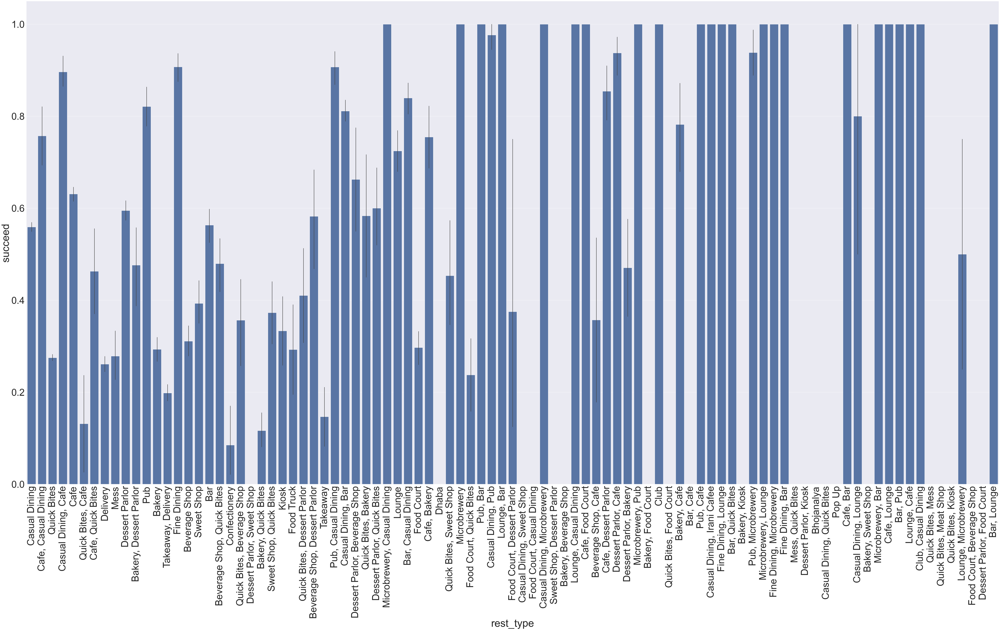

In [150]:
plt.xticks(rotation=90) # text rotation to vertical

sns.set(rc={'figure.figsize': [100, 50]}, font_scale=5)  # Standard figure size for all
sns.barplot(eda,x='rest_type',y='succeed')

###### Most succeeded locations in average and its average rate

In [151]:
eda.groupby(['location']).agg({
    'succeed':'mean',
    'name':'count',
    'rate':'mean'
}).sort_values(by='succeed',ascending=False)[:60]

,succeed,name,rate
location,,,
Lavelle Road,0.836893,515,4.027184
Langford Town,0.814815,27,3.807407
Church Street,0.785841,565,3.864956
Koramangala 3rd Block,0.768519,216,3.740278
St. Marks Road,0.764205,352,3.914489
Koramangala 5th Block,0.745194,2445,3.880920
Cunningham Road,0.673469,490,3.781429
MG Road,0.649496,893,3.589418
Koramangala 4th Block,0.640923,997,3.456720


###### Most succeeded city in average and its average rate

In [152]:
eda.groupby(['listed_in(city)']).agg({
    'succeed':'mean',
    'name':'count',
    'rate':'mean'
}).sort_values(by='succeed',ascending=False)

,succeed,name,rate
listed_in(city),,,
Church Street,0.538111,1758,3.453043
MG Road,0.537939,1766,3.448907
Brigade Road,0.536443,1715,3.445306
Indiranagar,0.515204,1743,3.468176
Residency Road,0.515113,1588,3.392292
Lavelle Road,0.505882,1700,3.390771
Old Airport Road,0.482507,1372,3.416567
Koramangala 6th Block,0.480458,2533,3.356932
Koramangala 4th Block,0.475551,2679,3.363960


###### Most succeeded locations for each city in average and its average rate

In [153]:
eda.groupby(['listed_in(city)','location']).agg({
    'succeed':'mean',
    'name':'count',
    'rate':'mean'
}).sort_values(by='succeed',ascending=False)[:60]

succeed  name      rate
listed_in(city)       location                                       
Koramangala 5th Block CV Raman Nagar         1.000000     1  5.000000
Kalyan Nagar          Koramangala 5th Block  1.000000     1  3.800000
Church Street         Jeevan Bhima Nagar     1.000000     1  3.800000
Jayanagar             CV Raman Nagar         1.000000     1  5.000000
Church Street         Basavanagudi           1.000000     1  4.500000
Brookefield           Old Airport Road       1.000000     1  4.400000
                      KR Puram               1.000000     1  5.000000
Brigade Road          Old Airport Road       1.000000     1  3.900000
                      Jeevan Bhima Nagar     1.000000     1  3.800000
Old Airport Road      Koramangala 6th Block  1.000000     6  4.116667
Church Street         Old Airport Road       1.000000     2  4.150000
Kammanahalli          Indiranagar            1.000000     1  4.400000
                      Koramangala 5th Block  1.000000     3  3.800000
Bellandur             Frazer Town            1.000000     1  3.800000
Koramangala 6th Block Brigade Road           1.000000     1  3.800000
Basavanagudi          Richmond Road          1.000000     3  4.033333
Residency Road        Jalahalli              1.000000     1  5.000000
                      Jayanagar              1.000000     2  3.950000
Church Street         Koramangala 6th Block  1.000000     1  4.100000
MG Road               Koramangala 6th Block  1.000000     2  3.950000
Residency Road        Koramangala 6th Block  1.000000     2  3.950000
Frazer Town           Koramangala 5th Block  1.000000     3  3.800000
Lavelle Road          Jalahalli              1.000000     1  5.000000
                      Jayanagar              1.000000     2  3.950000
                      Koramangala 8th Block  1.000000     1  4.000000
HSR                   Whitefield             1.000000     2  3.900000
                      Koramangala 3rd Block  1.000000     9  4.288889
                      Frazer Town            1.000000     1  3.800000
Frazer Town           Richmond Road          1.000000     2  4.050000
JP Nagar              CV Raman Nagar         1.000000     1  5.000000
MG Road               Jeevan Bhima Nagar     1.000000     1  3.800000
Frazer Town           Jeevan Bhima Nagar     1.000000     1  3.800000
                      HBR Layout             1.000000     3  3.833333
Koramangala 7th Block Langford Town          1.000000     4  3.900000
Frazer Town           BTM                    1.000000     1  4.000000
MG Road               Jalahalli              1.000000     1  5.000000
Electronic City       Koramangala 8th Block  1.000000     2  3.800000
                      Hosur Road             1.000000     2  4.000000
Residency Road        Koramangala 4th Block  1.000000     1  4.000000
Indiranagar           Kaggadasapura          1.000000     1  4.000000
Whitefield            Old Airport Road       1.000000     1  5.000000
Koramangala 4th Block Frazer Town            1.000000     1  3.800000
BTM                   Vasanth Nagar          1.000000     1  3.800000
Frazer Town           Lavelle Road           0.928571    14  4.192857
                      St. Marks Road         0.923077    13  4.076923
MG Road               Lavelle Road           0.880000   100  4.104000
Indiranagar           MG Road                0.861538    65  3.971538
Brigade Road          Koramangala 5th Block  0.857143     7  3.828571
Residency Road        Lavelle Road           0.836957    92  3.945652
Brigade Road          Lavelle Road           0.826923   104  4.086538
Lavelle Road          Lavelle Road           0.816327    98  3.969388
Church Street         Lavelle Road           0.813084   107  3.999065
                      Church Street          0.811966   117  3.831624
Brigade Road          Church Street          0.805556   108  3.817593
MG Road               Langford Town          0.800000     5  3.800000
Church Street         Langford Town          0.800000   

###### Most fail location in each city and count and its rate in average

In [154]:
eda.groupby(['listed_in(city)','location']).agg({
    'succeed':'mean',
    'name':'count',
    'rate':'mean'
}).sort_values(by='succeed')[:60]

succeed  name      rate
listed_in(city)       location                                      
MG Road               Kammanahalli               0.0     1  3.200000
                      East Bangalore             0.0     1  3.600000
                      Central Bangalore          0.0     2  3.600000
Lavelle Road          Uttarahalli                0.0     1  0.000000
Church Street         Uttarahalli                0.0     1  0.000000
Lavelle Road          Sanjay Nagar               0.0     1  3.500000
                      RT Nagar                   0.0     3  1.133333
Electronic City       Bommanahalli               0.0     1  3.300000
Lavelle Road          Malleshwaram               0.0     3  2.466667
Electronic City       South Bangalore            0.0     3  2.200000
Lavelle Road          Kumaraswamy Layout         0.0     2  0.000000
                      Koramangala 7th Block      0.0     2  3.400000
                      Koramangala 5th Block      0.0     1  3.400000
                      Kammanahalli               0.0     1  3.200000
Frazer Town           City Market                0.0     2  3.500000
Lavelle Road          HSR                        0.0     1  0.000000
                      HBR Layout                 0.0     2  0.000000
                      Ejipura                    0.0     1  3.400000
                      Central Bangalore          0.0     2  3.600000
Frazer Town           Jakkur                     0.0     1  0.000000
Lavelle Road          Bannerghatta Road          0.0     1  3.300000
Koramangala 7th Block Ulsoor                     0.0     1  3.500000
                      Residency Road             0.0     1  3.000000
Frazer Town           Malleshwaram               0.0     1  0.000000
                      New BEL Road               0.0     1  0.000000
                      North Bangalore            0.0     1  3.600000
Church Street         RT Nagar                   0.0     1  3.400000
                      Old Madras Road            0.0     2  3.000000
MG Road               HBR Layout                 0.0     2  0.000000
Church Street         Malleshwaram               0.0     2  0.000000
Brookefield           Bellandur                  0.0     1  0.000000
Malleshwaram          Yelahanka                  0.0     2  3.500000
                      West Bangalore             0.0     2  3.400000
                      Majestic                   0.0     7  1.614286
                      Magadi Road                0.0     1  3.400000
Church Street         Bannerghatta Road          0.0     1  3.300000
Malleshwaram          Frazer Town                0.0     6  2.800000
MG Road               Uttarahalli                0.0     1  0.000000
Church Street         Central Bangalore          0.0     1  3.700000
                      Domlur                     0.0     1  3.000000
                      Ejipura                    0.0     2  3.550000
MG Road               RT Nagar                   0.0     1  3.400000
Frazer Town           Old Madras Road            0.0     2  3.000000
Church Street         HBR Layout                 0.0     2  0.000000
MG Road               Old Madras Road            0.0     3  2.900000
                      Malleshwaram               0.0     1  0.000000
Church Street         Jalahalli                  0.0     1  0.000000
MG Road               Majestic                   0.0     2  3.450000
Church Street         Kammanahalli               0.0     1  3.200000
                      Koramangala 5th Block      0.0     1  3.400000
MG Road               Koramangala 8th Block      0.0     1  3.000000
Church Street         Koramangala 7th Block      0.0     1  3.600000
                      Kumaraswamy Layout         0.0     2  0.000000
MG Road               Koramangala 7th Block      0.0     2  3.400000
Kalyan Nagar          New BEL Road               0.0     1  0.000000
MG Road               HSR                        0.0     1  0.000000
Church Street         HSR                  

###### **Most succeed cuisines in average**

In [155]:
eda.groupby(['cuisines']).agg({
    'succeed':'mean',
    'name':'count',
        'rate':'mean'
}).sort_values(by='succeed',ascending=False)[:60]

,succeed,name,rate
cuisines,,,
"African, Burger",1.0,11,4.590909
"Fast Food, Burger, Beverages, Rolls, Sandwich",1.0,2,3.900000
"Fast Food, Beverages, Rolls",1.0,4,3.900000
"Fast Food, Beverages, Momos",1.0,2,3.900000
"Fast Food, Bengali, Rolls",1.0,6,4.150000
"Fast Food, American, Chinese",1.0,11,3.900000
"European, Spanish, Continental, Italian",1.0,4,3.950000
"European, North Indian, Mediterranean, Asian, Salad",1.0,19,4.200000
"European, Mediterranean, Salad",1.0,2,4.100000


###### **Most unsucceeded cuisines in average**

In [156]:
eda.groupby(['cuisines']).agg({
    'succeed':'mean',
    'name':'count',
        'rate':'mean'

}).sort_values(by='succeed')[:60]

,succeed,name,rate
cuisines,,,
"Fast Food, North Indian, Street Food",0.0,3,3.700000
"Chinese, Rolls, Momos",0.0,3,3.100000
"Chinese, Rolls, Fast Food",0.0,2,0.000000
"Momos, Fast Food, Burger, North Indian, Desserts, Biryani",0.0,2,0.000000
"Chinese, Rolls, Beverages",0.0,2,3.400000
"Pizza, Sandwich, Burger, Fast Food",0.0,2,3.500000
"Chinese, Oriya, North Indian, Bengali",0.0,2,3.600000
"Momos, Street Food, Fast Food, Tibetan, Chinese",0.0,3,3.600000
"Chinese, North Indian, South Indian, Street Food",0.0,8,3.700000


###### Most succeeded restaurants 'name' and its average rate

In [157]:
eda.groupby(['name']).agg({
    'succeed':'mean',
    'name':'count',
        'rate':'mean'
}).sort_values(by='succeed',ascending=False)[:60]

,succeed,name,rate
name,,,
Taste of Coastal,1.0,2,4.250000
Django,1.0,8,4.000000
Priyadarshini Veg,1.0,1,3.900000
Maa Tara Hotel,1.0,2,3.800000
Sukh Sagar Food Court,1.0,1,3.800000
DinePost9,1.0,12,3.866667
Sugary Bakers - A Boutique Bakery,1.0,8,5.000000
District 6 Pub Brewery & Kitchen,1.0,4,4.300000
Dive,1.0,2,4.300000


In [158]:
eda.groupby(['name']).agg({
    'succeed':'mean',
    'name':'count',
        'rate':'mean'
}).sort_values(by='rate',ascending=False)[:60]

,succeed,name,rate
name,,,
Foody's Take Away,1.0,3,5.0
Yumkiin,1.0,1,5.0
Sri Krishna Delight,1.0,8,5.0
Oveanly,1.0,6,5.0
Talk of the Town,1.0,4,5.0
Cluckees,1.0,2,5.0
Yummy Pot,1.0,5,5.0
Foody's Land,1.0,10,5.0
Tandoori,1.0,6,5.0


In [163]:
eda[eda['rate']!=5].groupby(['name']).agg({
    'rate':'mean',
    'name':'count',
    'succeed':'mean'
}).sort_values(by='rate',ascending=False)[:40]

,rate,name,succeed
name,,,
Asia Kitchen By Mainland China,4.900000,19,1.0
Byg Brewski Brewing Company,4.900000,6,1.0
SantÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂ© Spa Cuisine,4.900000,1,1.0
Punjab Grill,4.871429,7,1.0
Belgian Waffle Factory,4.844828,29,1.0
Flechazo,4.800000,6,1.0
The Pizza Bakery,4.800000,6,1.0
O.G. Variar & Sons,4.800000,2,1.0
Biergarten,4.766667,15,1.0


In [161]:
eda.groupby(['location','name']).agg({
    'rate':'mean',
    'name':'count'
}).sort_values(by='rate',ascending=False)[:40]

,,rate,name
location,name,,
JP Nagar,The Crazy Wall,5.0,3
Majestic,Karnataka Chats,5.0,1
KR Puram,Dhruva's Munch & Sip,5.0,1
HBR Layout,Bismillah Kabab Center,5.0,2
Malleshwaram,Swadh Biryani Tandoori Spot,5.0,2
Indiranagar,All Seasons Restaurants,5.0,2
KR Puram,Moon King Hotel,5.0,2
Shanti Nagar,New Ambur Biryani,5.0,3
Thippasandra,Delicious Treat,5.0,2
